# Analyzing the relationship between lyrical complexity and song popularity
This study analyzes the relationship between lyrical complexity and song popularity on Spotify, using readability metrics like the Flesch-Kincaid Index to quantify lyric depth.
By correlating these metrics with streaming data, we aim to uncover patterns that may reveal how complex lyrics impact listener engagement and commercial success.

In this notebook, we will explore the relationship between lyrical complexity and song popularity on Spotify, and demonstrate how to analyze and visualize these patterns using natural language processing and popularity metrics.

## Imports
Let's being with necessary python imports for the analysis.

In [1]:
import requests
import pandas as pd
import altair as alt
import json

import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

!pip install textstat
from textstat import flesch_reading_ease, gunning_fog

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

from wordcloud import WordCloud

from textblob import TextBlob

import seaborn as sns
import matplotlib.pyplot as plt

import plotly.express as px
import plotly.graph_objects as go

from google.colab import drive
drive.mount('/content/drive')

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.1/105.1 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 12.1 MB/s eta 0:00:00
Mounted at /content/drive


## Load Data

Now, we load the dataset containing song metadata from Spotify, which includes features such as song lyrics, popularity metrics, genres, and other relevant attributes.

In [2]:
# Load Spotify dataset
spotify_df = pd.read_csv('/content/drive/My Drive/DV/data.csv')
print(spotify_df.head(5))

# Load Lyrics dataset
lyrics_df = pd.read_csv('/content/drive/My Drive/DV/Spotify Million Song Dataset_exported.csv')
print(lyrics_df.head(5))

   Position                  Track Name         Artist  Streams  \
0         1  Reggaetón Lento (Bailemos)           CNCO    19272   
1         2                    Chantaje        Shakira    19270   
2         3   Otra Vez (feat. J Balvin)  Zion & Lennox    15761   
3         4                Vente Pa' Ca   Ricky Martin    14954   
4         5                      Safari       J Balvin    14269   

                                                 URL        Date Region  
0  https://open.spotify.com/track/3AEZUABDXNtecAO...  2017-01-01     ec  
1  https://open.spotify.com/track/6mICuAdrwEjh6Y6...  2017-01-01     ec  
2  https://open.spotify.com/track/3QwBODjSEzelZyV...  2017-01-01     ec  
3  https://open.spotify.com/track/7DM4BPaS7uofFul...  2017-01-01     ec  
4  https://open.spotify.com/track/6rQSrBHf7HlZjtc...  2017-01-01     ec  
  artist                   song                                        link  \
0   ABBA  Ahe's My Kind Of Girl  /a/abba/ahes+my+kind+of+girl_20598417.htm

## Data exploration
Now that we have the data loaded, let's begin by examining the basic structure and key metrics of our dataset. Understanding the dimensions of the data helps us ensure that we have all the necessary information for analysis and gives us a sense of the dataset's size and completeness. We'll look at the number of rows and columns in both the Spotify and Lyrics dataframes to verify that the data is properly loaded and ready for exploration.

In [3]:
print(spotify_df.shape)
print(lyrics_df.shape)

(3441197, 7)
(57650, 4)


We check for missing values to ensure data quality and avoid issues that could affect our analysis.

In [4]:
print(spotify_df.isnull().sum())
print(lyrics_df.isnull().sum())

Position        0
Track Name    657
Artist        657
Streams         0
URL             8
Date            0
Region          0
dtype: int64
artist    0
song      0
link      0
text      0
dtype: int64


*The Spotify dataframe has missing values in the Track Name, Artist, and URL columns, while the Lyrics dataframe has no missing values.*

Let's look  calculate the total number of streams across all tracks in the dataset.

In [5]:
print(spotify_df.Streams.sum())

178569775235


We will now calculate the total number of streams across all tracks in the dataset. This gives us an understanding of the overall popularity and reach of the songs.

In [6]:
print(" Unique tracks: ", format(len(spotify_df['Artist'].str.cat(others=spotify_df['Track Name'], sep=' - ').unique()), ','))

 Unique tracks:  19,923


Let’s also explore how many unique artists are represented in the dataset. This provides insight into the diversity of artists and their representation on the platform.

In [7]:
print("Unique Artists: ", format(len(spotify_df.Artist.unique()), ','))

Unique Artists:  6,629


Finally, we’ll check the number of regions available in the dataset to understand the geographic spread of the data and its global reach.

In [8]:
print(len(spotify_df.Region.unique()), "Regions")
print(spotify_df.Region.unique())

54 Regions
['ec' 'fr' 'ar' 'fi' 'no' 'it' 'lt' 'ph' 'tw' 'nz' 'ee' 'tr' 'us' 'sv'
 'cr' 'de' 'cl' 'jp' 'br' 'hn' 'gt' 'ch' 'hu' 'ca' 'pe' 'be' 'my' 'dk'
 'bo' 'pl' 'at' 'pt' 'se' 'mx' 'pa' 'uy' 'is' 'es' 'cz' 'ie' 'nl' 'sk'
 'co' 'sg' 'id' 'do' 'lu' 'gb' 'global' 'py' 'au' 'lv' 'gr' 'hk']


*A total of 178,569,775,235 streams are represented in the dataset, with 19,923 unique tracks, 6,629 unique artists, and data from 53 regions (excluding the "global" region), showcasing its broad global reach and diverse musical content.*

#### Top 50 Tracks by streams

Now, let's dive deeper by analyzing the top 50 tracks based on stream counts. Using Altair, we create a bar chart to visualize these tracks, helping us identify which songs are the most popular and drive the highest engagement on the platform.


In [9]:
track_streams = spotify_df.groupby('Track Name')['Streams'].sum().reset_index()
top_50_tracks = track_streams.sort_values(by='Streams', ascending=False).head(50)

chart = alt.Chart(top_50_tracks).mark_bar().encode(
    x=alt.X('Track Name:N', sort='-y', title='Track Name'),
    y=alt.Y('Streams:Q', title='Streams'),
    color=alt.Color('Streams:Q', scale=alt.Scale(scheme='viridis')),
    tooltip=['Track Name:N', 'Streams:Q']
).properties(
    title='Top 50 Tracks by Total Streams',
    width=800,
    height=500
)
chart

alt.Chart(...)

By sorting the tracks based on their total streams, we can clearly see which songs have the highest engagement.

Before visualizing the data, we first calculate the total streams for each artist and identify the top 100 artists based on stream count. This allows us to focus on the artists who are driving the highest engagement on the platform.

#### Artist popularity by total streams

In [10]:
artist_data = spotify_df.groupby('Artist', as_index=False)['Streams'].sum()
top_artists = artist_data.sort_values(by='Streams', ascending=False).head(100)

print(top_artists.size)
print(top_artists)

200
                Artist     Streams
1627        Ed Sheeran  8913973976
1562             Drake  4523630992
5631  The Chainsmokers  4292590087
4641       Post Malone  3700404149
3050    Kendrick Lamar  3570665303
...                ...         ...
3987       Miley Cyrus   462934281
961       Carlos Vives   462191473
3526   Louis Tomlinson   459876593
563          Bad Bunny   457239767
3739     Manuel Turizo   449484915

[100 rows x 2 columns]


Now, using Altair, we create a bar chart to visualize the total streams for these artists. The chart is sorted by stream count, and the color scale provides a clearer view of the most popular artists, helping us easily identify those with the highest engagement on Spotify.

In [11]:
chart = alt.Chart(top_artists).mark_bar().encode(
    x=alt.X('Artist:N', sort=alt.EncodingSortField(field="Streams", op="sum", order='descending')),  # Sort by Streams
    y='Streams:Q',
    color=alt.Color('Artist:N', legend=None, scale=alt.Scale(scheme='viridis'))
).properties(
    title='Total Streams by Artist'
)
chart

alt.Chart(...)

This graph became less dynamic after 15 artists, as the variation in stream counts diminished. To make the visualization more intuitive and focused, we will now focus on the top 20 artists.

In [12]:
# artist popularity top 10
chart = alt.Chart(top_artists.head(20)).mark_bar().encode(
    x=alt.X('Artist:N', sort=alt.EncodingSortField(field="Streams", op="sum", order='descending')),  # Sort by Streams
    y='Streams:Q',
    color=alt.Color('Artist:N', legend=None, scale=alt.Scale(scheme='viridis'))
).properties(
    title='Total Streams by Artist',
    width=800,
    height=500
)
chart

alt.Chart(...)

Based on the graph, the top artists by stream count (approximately) are: Ed Sheeran with 9 billion streams, Drake with 4.5 billion, The Chainsmokers at 4.3 billion, Post Malone at 3.8 billion, and Kendrick Lamar at 3.6 billion streams.

#### Geographical Distribution of Data

Now that we have the region data, let's examine the geographical distribution of the streams. We’ll use a geoJSON file to create a choropleth map visualization, which will allow us to map the stream counts to specific countries. This will help us better understand the global spread of the data and identify regional trends in music streaming.

In [13]:
spotify_df['Region'].unique()

region_counts = spotify_df['Region'].value_counts().reset_index()
region_counts.columns = ['Region', 'Count']

geojson_url = 'https://raw.githubusercontent.com/johan/world.geo.json/master/countries.geo.json'
geojson_data = requests.get(geojson_url).json()

In [14]:
region_counts.head(5)

,Region,Count
0,ec,74200
1,mx,74200
2,pe,74200
3,be,74200
4,fr,74200


In [15]:
print(geojson_data['features'][0]['properties'])

{'name': 'Afghanistan'}


In order to visualize the geographical distribution of streams on a map, we need to map the region codes in the dataset to their corresponding country codes. This mapping is necessary because geoJSON files typically use standardized ISO 3166-1 alpha-3 country codes (such as 'USA' for the United States, 'FRA' for France) to represent countries.

In [16]:
region_mapping = {
    'ec': 'ECU', 'fr': 'FRA', 'ar': 'ARG', 'fi': 'FIN', 'no': 'NOR', 'it': 'ITA',
    'lt': 'LTU', 'ph': 'PHL', 'tw': 'TWN', 'nz': 'NZL', 'ee': 'EST', 'tr': 'TUR',
    'us': 'USA', 'sv': 'SLV', 'cr': 'CRI', 'de': 'DEU', 'cl': 'CHL', 'jp': 'JPN',
    'br': 'BRA', 'hn': 'HND', 'gt': 'GTM', 'ch': 'CHE', 'hu': 'HUN', 'ca': 'CAN',
    'pe': 'PER', 'be': 'BEL ', 'my': 'MYS', 'dk': 'DNK', 'bo': 'BOL', 'pl': 'POL',
    'at': 'AUT', 'pt': 'PRT', 'se': 'SWE', 'mx': 'MEX', 'pa': 'PAN', 'uy': 'URY',
    'is': 'ISL', 'es': 'ESP', 'cz': 'CZE', 'ie': 'IRL', 'nl': 'NLD', 'sk': 'SVK',
    'co': 'COL', 'sg': 'SGP', 'id': 'IDN', 'do': 'DOM', 'lu': 'LUX', 'gb': 'GBR',
    'py': 'PRY', 'au': 'AUS', 'lv': 'LVA', 'gr': 'GRC', 'hk': 'HKG'
}

track_counts = spotify_df.groupby('Region').size().reset_index(name='Track Count')
track_counts['country_code'] = track_counts['Region'].map(region_mapping)

track_counts.head(5)

,Region,Track Count,country_code
0,ar,74200,ARG
1,at,74200,AUT
2,au,74200,AUS
3,be,74200,BEL
4,bo,39838,BOL


In [17]:
track_counts['country_code'].unique()
track_counts = track_counts.dropna(subset=['country_code'])

track_counts['country_code'].unique()

array(['ARG', 'AUT', 'AUS', 'BEL ', 'BOL', 'BRA', 'CAN', 'CHE', 'CHL',
       'COL', 'CRI', 'CZE', 'DEU', 'DNK', 'DOM', 'ECU', 'EST', 'ESP',
       'FIN', 'FRA', 'GBR', 'GRC', 'GTM', 'HKG', 'HND', 'HUN', 'IDN',
       'IRL', 'ISL', 'ITA', 'JPN', 'LTU', 'LUX', 'LVA', 'MEX', 'MYS',
       'NLD', 'NOR', 'NZL', 'PAN', 'PER', 'PHL', 'POL', 'PRT', 'PRY',
       'SWE', 'SGP', 'SVK', 'SLV', 'TUR', 'TWN', 'USA', 'URY'],
      dtype=object)

In [18]:
track_chart = alt.Chart(alt.Data(values=geojson_data['features'])).mark_geoshape(
    stroke='black',
    strokeWidth=0.5
).encode(
    color=alt.Color('Track Count:Q', scale=alt.Scale(scheme='viridis')),
    tooltip=['properties.name:N', 'Track Count:Q']
).transform_lookup(
    lookup='id',
    from_=alt.LookupData(track_counts, 'country_code', ['Track Count'])
).project('naturalEarth1').properties(
    width=800,
    height=500,
    title="Track Count by Region"
)

track_chart

alt.Chart(...)

Each country is colored based on the number of tracks from that region, with the track count mapped using the country_code as a reference. The map employs the naturalEarth1 projection for a global view and uses a color scale to highlight regions with higher track counts. Tooltips are displayed when hovering over the countries, providing more detailed information on the track count for each region.

#### Ed Sheeran: Global track distribution

Since Ed Sheeran is both the top artist and has the top track ("Shape of You") with the highest stream count by a significant margin, we focus on his tracks to explore the global distribution.

In [19]:
# ed sheeran - global

ed_sheeran_tracks = spotify_df[spotify_df['Artist'] == 'Ed Sheeran']
ed_sheeran_region_counts = ed_sheeran_tracks.groupby('Region').size().reset_index(name='Track Count')
ed_sheeran_region_counts['country_code'] = ed_sheeran_region_counts['Region'].map(region_mapping)
ed_sheeran_region_counts = ed_sheeran_region_counts.dropna(subset=['country_code'])
print(ed_sheeran_region_counts['country_code'].unique())

ed_sheeran_track_chart = alt.Chart(alt.Data(values=geojson_data['features'])).mark_geoshape(
    stroke='black',
    strokeWidth=0.5
).encode(
    color=alt.Color('Track Count:Q', scale=alt.Scale(scheme='viridis')),
    tooltip=['properties.name:N', 'Track Count:Q']
).transform_lookup(
    lookup='id',
    from_=alt.LookupData(ed_sheeran_region_counts, 'country_code', ['Track Count'])
).project('naturalEarth1').properties(
    width=800,
    height=500,
    title="Ed Sheeran Track Count by Region"
)

# Display the chart
ed_sheeran_track_chart

['ARG' 'AUT' 'AUS' 'BEL ' 'BOL' 'BRA' 'CAN' 'CHE' 'CHL' 'COL' 'CRI' 'CZE'
 'DEU' 'DNK' 'DOM' 'ECU' 'EST' 'ESP' 'FIN' 'FRA' 'GBR' 'GRC' 'GTM' 'HKG'
 'HND' 'HUN' 'IDN' 'IRL' 'ISL' 'ITA' 'JPN' 'LTU' 'LUX' 'LVA' 'MEX' 'MYS'
 'NLD' 'NOR' 'NZL' 'PAN' 'PER' 'PHL' 'POL' 'PRT' 'PRY' 'SWE' 'SGP' 'SVK'
 'SLV' 'TUR' 'TWN' 'USA' 'URY']


alt.Chart(...)

The chart visualizes the global distribution of Ed Sheeran's tracks, showing the regions where his music has the highest presence, with colors representing the track counts for each region.

The plot reveals that the UK and Ireland have the highest track counts for Ed Sheeran, which is unsurprising given that these are his home countries, where he likely has the most supporters and fans. The map visually emphasizes these regions with darker shades, reflecting his strong popularity and presence in these areas compared to the rest of the world.

## Data Analysis
#### Standardizing Datasets

Before performing any analysis, we need to ensure that both the Spotify and Lyrics datasets are in a consistent format. This is why we standardize the data by converting the track names and artist names to lowercase and removing any extra spaces.

In [20]:
# Standardize Spotify dataset
spotify_df['Track Name'] = spotify_df['Track Name'].str.lower().str.strip()
spotify_df['Artist'] = spotify_df['Artist'].str.lower().str.strip()

# Standardize Lyrics dataset
lyrics_df['song'] = lyrics_df['song'].str.lower().str.strip()
lyrics_df['artist'] = lyrics_df['artist'].str.lower().str.strip()

Once the datasets are standardized, we merge them based on the song title and artist name allowing us to create a unified dataset that contains both the streaming data (from Spotify) and the lyrical content (from the Lyrics dataset) for each track. By using an inner join, we retain only the tracks that have matching entries in both datasets, which is essential for our analysis of lyrical complexity and popularity.

In [21]:
# Merge the datasets on song title and artist name
merged_df = pd.merge(spotify_df, lyrics_df,
                     left_on=['Track Name', 'Artist'],
                     right_on=['song', 'artist'],
                     how='inner')
merged_df.head()

,Position,Track Name,Artist,Streams,URL,Date,Region,artist,song,link,text
0,21,don't wanna know,maroon 5,6582,https://open.spotify.com/track/5MFzQMkrl1FOOng...,2017-01-01,ec,maroon 5,don't wanna know,/m/maroon+5/dont+wanna+know_21111444.html,[Intro] \nOh hey \nOh hey \nOh hey \n \n[...
1,23,24k magic,bruno mars,6261,https://open.spotify.com/track/6b8Be6ljOzmkOmF...,2017-01-01,ec,bruno mars,24k magic,/b/bruno+mars/24k+magic_21111370.html,[Intro] \nTonight \nI just want to take you ...
2,41,cheap thrills,sia,4300,https://open.spotify.com/track/27SdWb2rFzO6GWi...,2017-01-01,ec,sia,cheap thrills,/s/sia/cheap+thrills_21104995.html,"[Verse 1] \nCome on, come on, turn the radio ..."
3,50,heathens,twenty one pilots,3376,https://open.spotify.com/track/6i0V12jOa3mr6uu...,2017-01-01,ec,twenty one pilots,heathens,/t/twenty+one+pilots/heathens_21108974.html,"[Intro] \nAll my friends are heathens, take i..."
4,70,ride,twenty one pilots,2604,https://open.spotify.com/track/2Z8WuEywRWYTKe1...,2017-01-01,ec,twenty one pilots,ride,/t/twenty+one+pilots/ride_21098475.html,[Verse 1] \nI just wanna stay in the sun wher...


#### Preprocessing Lyrics

To analyze the lyrical content, we first need to preprocess the text. This involves several steps to clean and standardize the lyrics for further analysis:

1. **Remove Annotations**: We use a regular expression to remove any annotations or references (e.g., `[Intro]`, `[Chorus]`).
2. **Remove Non-Alphabetic Characters**: We remove any non-alphabetic characters to focus only on the words.
3. **Lowercasing**: Convert all the text to lowercase to ensure uniformity.
4. **Tokenization**: We split the text into individual words (tokens) using NLTK's `word_tokenize` function.
5. **Stopword Removal**: We filter out common stopwords (like "the", "and", "a", etc.) that don’t contribute much meaning to the analysis.
6. **Lemmatization**: Finally, we apply lemmatization to reduce words to their base form (e.g., "running" becomes "run").

The result is a cleaned and processed version of the lyrics that is ready for further analysis, such as measuring lyrical complexity or exploring themes and sentiment.

In [22]:
nltk.download('all')

# Preprocessing lyrics
stop_words = set(stopwords.words('english'))
lemmatizer = WordNetLemmatizer()

def preprocess_lyrics(text):
    if not isinstance(text, str):
        return ""
    text = re.sub(r'\[.*?\]', '', text)
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    text = text.lower()
    tokens = word_tokenize(text)
    tokens = [lemmatizer.lemmatize(word) for word in tokens if word not in stop_words]
    return ' '.join(tokens)

[nltk_data] Downloading collection 'all'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/abc.zip.
[nltk_data]    | Downloading package alpino to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/alpino.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger_eng to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping
[nltk_data]    |       taggers/averaged_perceptron_tagger_eng.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger_ru to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping
[nltk_data]    |       taggers/averaged_perceptron_tagger_ru.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger_rus to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |  

In [23]:
print(merged_df.columns)

Index(['Position', 'Track Name', 'Artist', 'Streams', 'URL', 'Date', 'Region',
       'artist', 'song', 'link', 'text'],
      dtype='object')


In [24]:
merged_df.head()

,Position,Track Name,Artist,Streams,URL,Date,Region,artist,song,link,text
0,21,don't wanna know,maroon 5,6582,https://open.spotify.com/track/5MFzQMkrl1FOOng...,2017-01-01,ec,maroon 5,don't wanna know,/m/maroon+5/dont+wanna+know_21111444.html,[Intro] \nOh hey \nOh hey \nOh hey \n \n[...
1,23,24k magic,bruno mars,6261,https://open.spotify.com/track/6b8Be6ljOzmkOmF...,2017-01-01,ec,bruno mars,24k magic,/b/bruno+mars/24k+magic_21111370.html,[Intro] \nTonight \nI just want to take you ...
2,41,cheap thrills,sia,4300,https://open.spotify.com/track/27SdWb2rFzO6GWi...,2017-01-01,ec,sia,cheap thrills,/s/sia/cheap+thrills_21104995.html,"[Verse 1] \nCome on, come on, turn the radio ..."
3,50,heathens,twenty one pilots,3376,https://open.spotify.com/track/6i0V12jOa3mr6uu...,2017-01-01,ec,twenty one pilots,heathens,/t/twenty+one+pilots/heathens_21108974.html,"[Intro] \nAll my friends are heathens, take i..."
4,70,ride,twenty one pilots,2604,https://open.spotify.com/track/2Z8WuEywRWYTKe1...,2017-01-01,ec,twenty one pilots,ride,/t/twenty+one+pilots/ride_21098475.html,[Verse 1] \nI just wanna stay in the sun wher...


### Lyrical Complexity Metrics

The following metrics are calculated for each track:

1. **Flesch Reading Ease**: This metric evaluates how easy or difficult a text is to read. Higher values indicate easier readability.
2. **Gunning Fog Index**: This index estimates the years of formal education required to understand the text. A higher score indicates more complex, harder-to-read lyrics.
3. **Lexical Diversity**: This measures the richness of the vocabulary in the lyrics by calculating the ratio of unique words to total words. A higher value indicates a greater diversity of vocabulary.

These metrics are computed for each track and stored in new columns in the dataset (`flesch_reading_ease`, `gunning_fog_index`, and `lexical_diversity`), which will allow us to analyze the relationship between lyrical complexity and song popularity.


In [26]:
merged_df['processed_lyrics'] = merged_df['text'].apply(preprocess_lyrics)

# Calculate lyrical complexity metrics
merged_df['flesch_reading_ease'] = merged_df['processed_lyrics'].apply(flesch_reading_ease)
merged_df['gunning_fog_index'] = merged_df['processed_lyrics'].apply(gunning_fog)
merged_df['lexical_diversity'] = merged_df['processed_lyrics'].apply(
    lambda x: len(set(x.split())) / len(x.split()) if len(x.split()) > 0 else 0)

#### Lyrical Complexity by Region
Let's compute the mean Gunning Fog Index for each region, providing a measure of the overall lyrical complexity of songs in that region. By averaging the Gunning Fog Index across songs, we can gain insights into the general trend of lyrical sophistication in different parts of the world.

In [27]:
complexity_by_region = merged_df.groupby('Region')['gunning_fog_index'].mean().reset_index()
complexity_by_region.rename(columns={'gunning_fog_index': 'Average Complexity'}, inplace=True)

complexity_by_region['country_code'] = complexity_by_region['Region'].map(region_mapping)
complexity_by_region.head()

,Region,Average Complexity,country_code
0,ar,82.706651,ARG
1,at,72.241560,AUT
2,au,83.841383,AUS
3,be,74.667517,BEL
4,bo,87.653663,BOL


In this case, we are using a choropleth map to display the average complexity for each region. The regions are color-coded according to their average lyrical complexity, helping us visually understand which areas have more complex lyrics, based on the Gunning Fog Index.

In [28]:
complexity_chart = alt.Chart(alt.Data(values=geojson_data['features'])).mark_geoshape(
    stroke='black',
    strokeWidth=0.5
).encode(
    color=alt.Color('Track Count:Q', scale=alt.Scale(scheme='viridis')),
    tooltip=['properties.name:N', 'Track Count:Q']
).transform_lookup(
    lookup='id',
    from_=alt.LookupData(track_counts, 'country_code', ['Track Count'])
).project('naturalEarth1').properties(
    width=800,
    height=500,
    title="Track Count by Region"
)

track_chart

alt.Chart(...)

This visualization will display the regions colored by their lyrical complexity, providing insight into how different countries and regions vary in terms of lyrical depth and sophistication.

#### Correlation Analysis: Flesch Reading Ease vs. Streams
By examining the correlation between Flesch Reading Ease (a readability metric) and Streams (a measure of song popularity), we aim to uncover whether there is any significant relationship between the readability of lyrics and a song's popularity on the platform.

A positive correlation would suggest that more easily readable lyrics are associated with higher streams, while a negative correlation would imply the opposite.

In [29]:
# Correlation analysis
print("Correlation between Flesch Reading Ease and Streams:")
print(merged_df[['flesch_reading_ease', 'Streams']].corr())

Correlation between Flesch Reading Ease and Streams:
                     flesch_reading_ease   Streams
flesch_reading_ease             1.000000 -0.042006
Streams                        -0.042006  1.000000


*The correlation coefficient between Flesch Reading Ease and Streams is -0.042, which indicates a very weak negative correlation. Songs with more readable (easier to understand) lyrics do not appear to have a significantly higher number of streams compared to those with more complex lyrics.*

*This weak correlation might imply that factors other than readability, such as genre, artist popularity, or melody, likely play a larger role in determining a song's streaming success.*

To better understand the relationship between lyrical readability and song popularity, we use a scatter plot to visualize the Flesch Reading Ease score against the number of Streams.

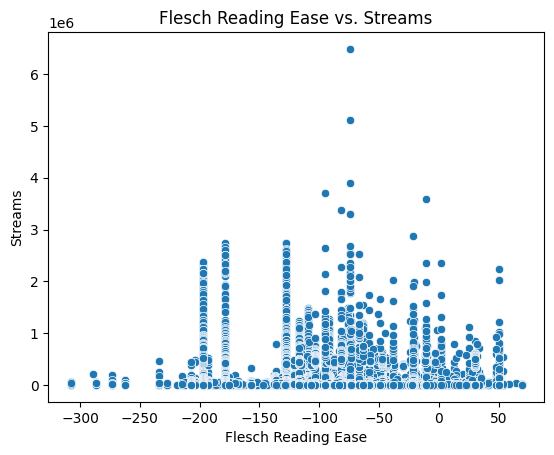

In [30]:
# Scatter plot for visualization
sns.scatterplot(data=merged_df, x='flesch_reading_ease', y='Streams')
plt.title('Flesch Reading Ease vs. Streams')
plt.xlabel('Flesch Reading Ease')
plt.ylabel('Streams')
plt.show()

To enhance our understanding of the relationship between Flesch Reading Ease and Stream Count, we create an interactive scatter plot using Plotly:

*   The size of each point is proportional to the number of streams, giving an additional layer of information on song popularity.
*   The color of the points is based on the Flesch Reading Ease score, providing a visual cue for lyric complexity.

In [31]:
fig = px.scatter(
    merged_df,
    x='flesch_reading_ease',
    y='Streams',
    color='flesch_reading_ease',
    color_continuous_scale = 'viridis' ,
    size='Streams',  # Size of points based on stream count
    hover_data={'flesch_reading_ease': True, 'Streams': True, 'Artist': True},  # Tooltip info
    labels={
        'flesch_reading_ease': 'Flesch Reading Ease',
        'Streams': 'Stream Count',
    },
    title='Popularity vs. Complexity'
)

# Update layout for better presentation
fig.update_traces(marker=dict(opacity=0.8))
fig.update_layout(
    xaxis_title='Flesch Reading Ease',
    yaxis_title='Streams'
)

# Display the plot
fig.show()

Let's see which artists have the most streams and how their popularity compares visually.

In [33]:
fig = px.scatter(
    merged_df,
    x='Artist',
    y='Streams',
    color='Artist',
    color_continuous_scale = 'viridis' ,
    size='Streams',  # Size of points based on stream count
    hover_data={'Streams': True, 'Artist': True},  # Tooltip info
    labels={
        'Artist': 'Artist',
        'Streams': 'Stream Count',
    },
    title='Artist vs. Popularity'
)

# Update layout for better presentation
fig.update_traces(marker=dict(opacity=0.8))
fig.update_layout(
    xaxis_title='Artist',
    yaxis_title='Streams'
)

# Display the plot
fig.show()

*In both the Flesch Reading Ease vs. Streams and Artist vs. Popularity scatter plots, Wham! stands out as a significant outlier. In the Artist vs. Popularity plot, Wham! shows a notably high stream count compared to other artists, making it a standout in terms of popularity. Similarly, in the Flesch Reading Ease vs. Streams plot, Wham! is associated with a high stream count, suggesting that their tracks strike a balance between accessibility (higher Flesch Reading Ease) and widespread popularity.*

#### 3D plot
We typically avoid using 3D plots due to their tendency to introduce visual clutter and make data interpretation more challenging. However, for this analysis, we chose to explore the relationships between Flesch Reading Ease, Streams, and Artist in three dimensions to potentially uncover patterns that may not be apparent in 2D scatter plots. Despite this, 2D scatter plots remain the preferred choice for clearer interpretation and more actionable insights.

In [ ]:
fig = go.Figure(data=[go.Scatter3d(
    x=merged_df['flesch_reading_ease'],
    y=merged_df['Streams'],
    z=merged_df['Artist'],
    mode='markers',
    marker=dict(
        size=10,
        color=merged_df['flesch_reading_ease'],  # Color by Flesch Reading Ease
        colorscale='Plasma',  # Change color scale to 'Cividis'
        opacity=0.8
    ),
     hovertemplate=(
        'Flesch Reading Ease: %{x}<br>' +
        'Streams: %{y}<br>' +
        'Artist: %{z}<extra></extra>'  # Hides the default "trace" label in the tooltip
    )
)])

# Add axis labels and title
fig.update_layout(
    title="Popularity vs. Complexity vs. Artists (3D Scatter)",
    scene=dict(
        xaxis_title='Flesch Reading Ease',
        yaxis_title='Streams',
        zaxis_title='Artist'
    )
)

fig.show()

#### Heatmap
Now, let's visualize the correlations between the Flesch Reading Ease, Gunning Fog Index, and Streams using a heatmap to identify if there are any strong relationships between these variables.

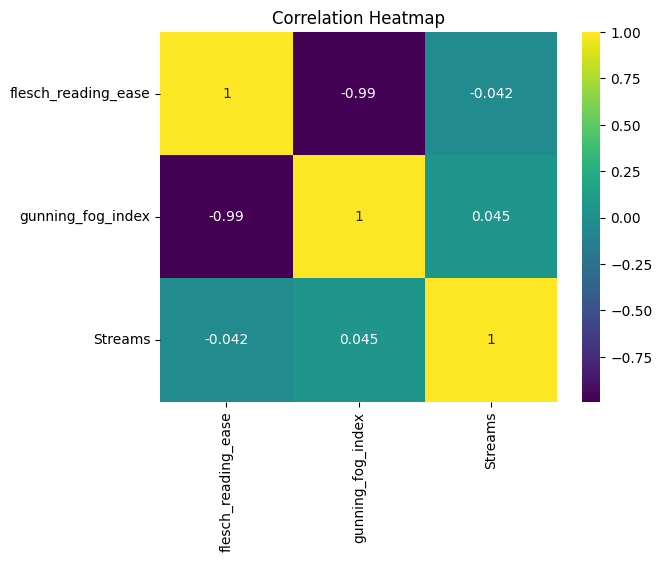

In [ ]:
# Heatmap of correlations
correlation_matrix = merged_df[['flesch_reading_ease', 'gunning_fog_index', 'Streams']].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='viridis')
plt.title('Correlation Heatmap')
plt.show()

The correlation matrix reveals the following:



*   **Flesch Reading Ease and Gunning Fog Index:** There is a strong negative correlation of -0.99 between these two metrics, meaning that as the Flesch Reading Ease increases (indicating easier-to-read lyrics), the Gunning Fog Index decreases (reflecting simpler text). This is expected since both indices assess readability, but in opposite ways.
*   **Flesch Reading Ease and Streams:** The correlation between Flesch Reading Ease and Streams is very weak (-0.04), suggesting that the ease of reading the lyrics has little to no effect on the number of streams a song receives.
*   **Gunning Fog Index and Streams:** Similarly, the correlation between the Gunning Fog Index and Streams is also weak (0.04), indicating that lyrical complexity, as defined by this index, does not strongly impact a song's popularity in terms of streams.

#### Word cloud
Now that we have preprocessed the lyrics, we can visualize the most common themes across all songs by generating a word cloud. This helps to identify the most frequently occurring words in the lyrics, highlighting recurring themes or topics. Words that appear larger in the cloud are those that appear more frequently in the lyrics dataset.

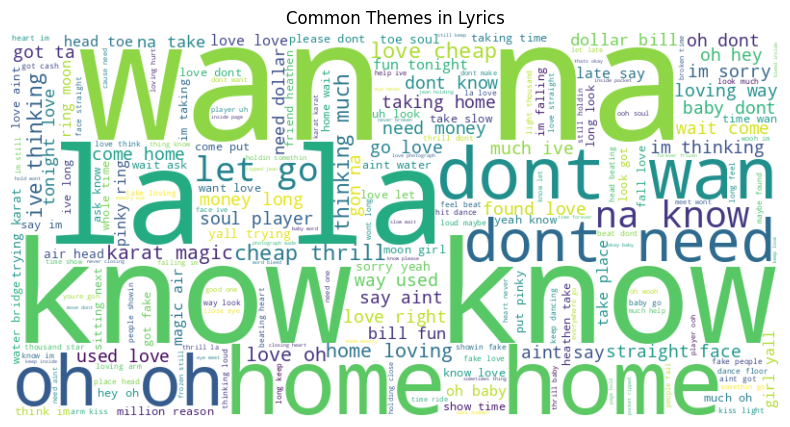

In [ ]:
# Word cloud for lyrical themes
text = ' '.join(merged_df['processed_lyrics'])
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Common Themes in Lyrics')
plt.show()

#### Predictive Modelling
In this section, we aim to build a predictive model to understand how various features, such as lyrical complexity (Flesch Reading Ease, Gunning Fog Index, and Lexical Diversity), can predict the number of streams a song receives. We use Linear Regression for this task.

Let's start by preparing our data for modeling. This includes handling any missing values, splitting the data into training and testing sets, and then training the Linear Regression model.

In [36]:
# Predictive modeling: Linear Regression
X = merged_df[['flesch_reading_ease', 'gunning_fog_index', 'lexical_diversity']]
y = merged_df['Streams']

# Handle missing values if any
X = X.fillna(X.mean())

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

LinearRegression()

Now, let's make predictions using our model and evaluate its performance by calculating the Mean Squared Error. We'll also visualize the predicted vs actual stream values to see how well our model is performing.

Mean Squared Error: 17025767172.708664


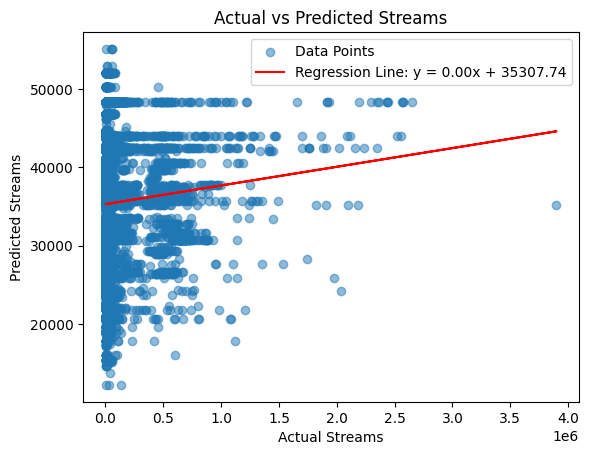

In [37]:
# # Predictions
# y_pred = model.predict(X_test)
# print(f'Mean Squared Error: {mean_squared_error(y_test, y_pred)}')

# # Visualize predictions vs actual values
# plt.scatter(y_test, y_pred, alpha=0.5)
# plt.title('Actual vs Predicted Streams')
# plt.xlabel('Actual Streams')
# plt.ylabel('Predicted Streams')
# plt.show()

import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error

# Predictions
y_pred = model.predict(X_test)
print(f'Mean Squared Error: {mean_squared_error(y_test, y_pred)}')

# Fit a regression line to the actual vs predicted values
m, b = np.polyfit(y_test, y_pred, 1)  # Linear regression to get slope (m) and intercept (b)

# Visualize predictions vs actual values
plt.scatter(y_test, y_pred, alpha=0.5, label='Data Points')
plt.plot(y_test, m * y_test + b, color='red', label=f'Regression Line: y = {m:.2f}x + {b:.2f}')
plt.title('Actual vs Predicted Streams')
plt.xlabel('Actual Streams')
plt.ylabel('Predicted Streams')
plt.legend()
plt.show()


*The scatter plot visualizes the relationship between actual and predicted stream counts using a linear regression model. There is a significant deviation between the predictions and actual values, with a noticeable spread and no clear alignment along the diagonal (ideal fit line).*

*This indicates the model has **poor predictive performance**, likely due to the limited explanatory power of the selected features (`flesch_reading_ease`, `gunning_fog_index`, `lexical_diversity`). The high **Mean Squared Error (17,025,767,172.71)** further hightlights the model's inability to accurately capture the variance in the data.*

#### TextBlob
Given the limitations of the regression model, we turn to TextBlob for sentiment analysis to extract deeper insights from the lyrics. By using sentiment analysis, we aim to uncover how the emotional tone and subjectivity of song lyrics may influence audience engagement and streaming success.

We’ll examine two key sentiment metrics:
*   **polarity** (ranging from -1 for negative to 1 for positive)
*   **subjectivity** (from 0 to 1, where 0 is highly objective and 1 is highly subjective)

In [38]:
def analyze_sentiment(text):
    """
    Analyze the sentiment of the text using TextBlob.
    Returns a dictionary with polarity and subjectivity scores.
    """
    if not isinstance(text, str) or text.strip() == "":
        return {'polarity': None, 'subjectivity': None}

    blob = TextBlob(text)
    return {
        'polarity': blob.sentiment.polarity,
        'subjectivity': blob.sentiment.subjectivity
    }

# Apply Sentiment Analysis to Processed Lyrics
sentiment_metrics = merged_df['processed_lyrics'].apply(analyze_sentiment)

# Convert Sentiment Metrics to DataFrame and Merge with Original
sentiment_df = pd.DataFrame(list(sentiment_metrics))
merged_df = pd.concat([merged_df, sentiment_df], axis=1)

# Save or Inspect Results
print(merged_df[['processed_lyrics', 'polarity', 'subjectivity']].head())
merged_df.to_csv('/content/drive/My Drive/DV/songs_with_sentiment_analysis.csv', index=False)

                                    processed_lyrics  polarity  subjectivity
0  oh hey oh hey oh hey dont wan na know know kno...  0.249393      0.501962
1  tonight want take higher throw hand sky let se...  0.124116      0.707925
2  come come turn radio friday night wont long go...  0.282791      0.514884
3  friend heathen take slow wait ask know please ...  0.014504      0.414187
4  wan na stay sun find know hard sometimes piece...  0.148030      0.275952


Now that we’ve gathered our sentiment metrics — polarity and subjectivity — we’re ready to visualize how these emotions in the lyrics relate to a song's popularity, which we're measuring through stream count.

We’ll size the points based on how popular the song is. The bigger the point, the more streams it has.

What we’re hoping to find here is a pattern: Do more positive songs tend to get more streams? Or maybe there’s something unique about the subjectivity of the lyrics?

In [39]:
# Create the scatter plot
fig = px.scatter(
    merged_df,
    x='polarity',
    y='Streams',
    color='polarity',
    color_continuous_scale = 'viridis' ,
    size='Streams',  # Size of points based on stream count
    hover_data={'polarity': True, 'Streams': True, 'song': True},  # Tooltip info
    labels={
        'polarity': 'Polarity',
        'Streams': 'Stream Count',
    },
    title='Popularity vs. Number of Streams'
)

# Update layout for better presentation
fig.update_traces(marker=dict(opacity=0.8))
fig.update_layout(
    xaxis_title='Polarity',
    yaxis_title='Streams'
)

# Display the plot
fig.show()

Let's take a closer look at the scatter plot we've just generated.
Do more positive songs get more streams? **Yes**, slightly positive songs (polarity between 0.1 and 0.3) tend to have higher stream counts. However, extreme positive or negative songs generally see fewer streams, possibly because they’re too intense or niche.

Is there something unique about subjectivity? Although we didn’t plot subjectivity directly, we can infer that songs with **moderate emotional tone** (both positive and negative) seem to resonate better with audiences. Too much subjectivity or extreme emotion might not appeal to as broad an audience.

What about extreme sentiments? They typically correlate with lower streams. This suggests that moderate emotional tones strike the best balance between emotional depth and relatability, which is more likely to drive popularity.

*To summarize, balanced emotional tones (moderate positivity or negativity) seem to be the sweet spot for higher streams.*

While the 2D scatter plot revealed how sentiment correlates with popularity, the histogram provides an overview of how common different sentiment levels are across all the lyrics.

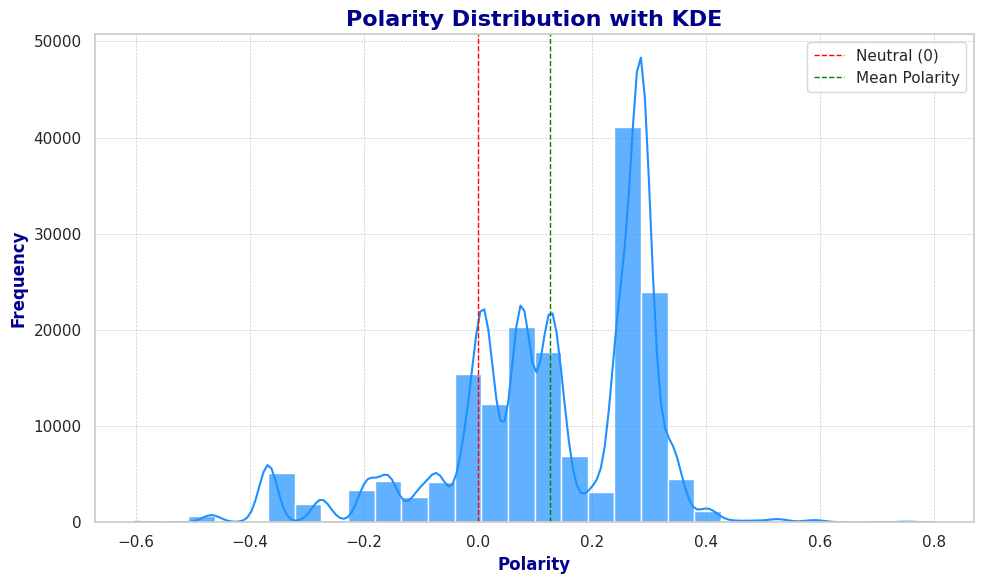

In [40]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set a modern style
sns.set_theme(style="whitegrid")

# Create the histogram with enhancements
plt.figure(figsize=(10, 6))  # Adjust figure size for better visibility
sns.histplot(
    merged_df['polarity'],
    kde=True,
    bins=30,
    color='dodgerblue',  # Use a visually appealing color
    alpha=0.7  # Adjust transparency for better layering
)

# Add vertical lines for reference
plt.axvline(0, color='red', linestyle='--', linewidth=1, label='Neutral (0)')  # Neutral polarity line
plt.axvline(merged_df['polarity'].mean(), color='green', linestyle='--', linewidth=1, label='Mean Polarity')

# Enhance titles and labels
plt.title('Polarity Distribution with KDE', fontsize=16, fontweight='bold', color='darkblue')
plt.xlabel('Polarity', fontsize=12, fontweight='bold', color='darkblue')
plt.ylabel('Frequency', fontsize=12, fontweight='bold', color='darkblue')

# Add a legend
plt.legend()

# Add gridlines
plt.grid(visible=True, which='major', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()
plt.show()


*The KDE curve helped us see how sentiment gradually shifts across the dataset.
In general, the overall sentiment skew toward positive sentiment with olarity values generally in the range of -0.4 and 0.6. The most frequent polarity value is around 0.2. While negative values do exist, particularly those as low as -0.6, their occurrence is much less frequent.*

Let's examine if there's a "sweet spot" for both subjectivity and polarity that resonates with listeners with a scatter plot.

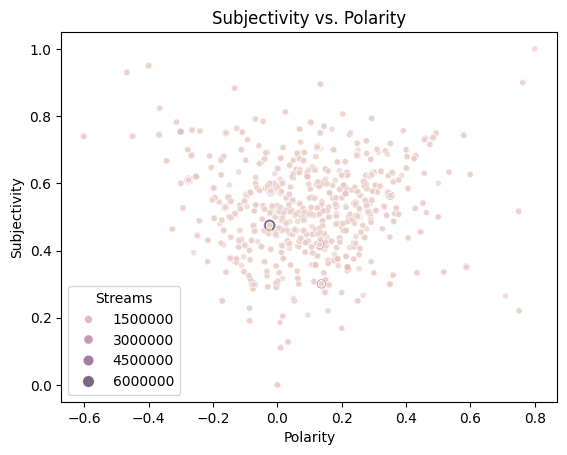

In [ ]:
sns.scatterplot(data=merged_df, x='polarity', y='subjectivity', hue='Streams', size='Streams', alpha=0.7)
plt.title('Subjectivity vs. Polarity')
plt.xlabel('Polarity')
plt.ylabel('Subjectivity')
plt.show()

*Most data points cluster around the center of the plot, indicating a moderate level of subjectivity and polarity.*

Let's analyse the distribution of data points and identify patterns within each quandrant.

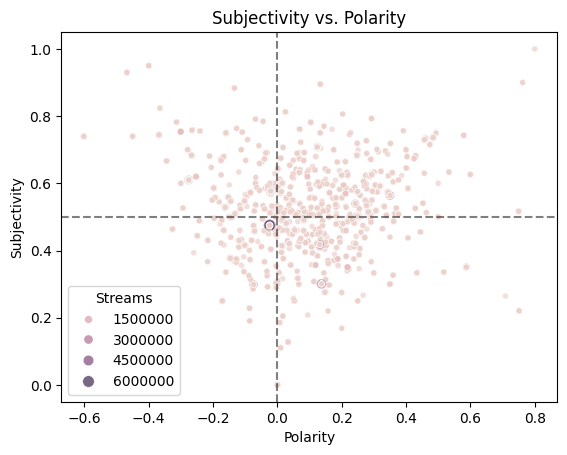

In [ ]:
sns.scatterplot(data=merged_df, x='polarity', y='subjectivity', hue='Streams', size='Streams', alpha=0.7)
plt.title('Subjectivity vs. Polarity')
plt.xlabel('Polarity')
plt.ylabel('Subjectivity')


plt.axhline(0.5, color='black', linestyle='--', alpha = 0.5)
plt.axvline(0, color='black', linestyle='--', alpha = 0.5)

Both positive and negative polarity indicates moderate subjectivity. This implies that songs with higher positive sentiment as well as songs with negative sentiment tend to be moderately subjective; positive emotions, sadness or anger are often expressed through personal experiences or opinions that the listeners might resonate to. A few outliers, as expected, might express strong emotions or highly personal opinions.